# Rock Daisy Visualization Notebook

This notebook includes various visualizations of rock daisies throughout the Americas. 

# 1. Imports

In [60]:
import numpy as np
import pandas as pd
from rockdaisy.nomenclator import Nomenclator
from rockdaisy.plotting import plot_geographical_positions, plot_geographical_heatmap_overlay, plot_3d_relief_with_species

import pyvista as pv
import ipywidgets
import trame
pv.set_jupyter_backend('trame')  # <-- Important line

# 2. Nomenclator

In [3]:
nomenclator_filepath = '../data/nomenclator.txt'
nomenclator = Nomenclator(nomenclator_filepath)

In [4]:
nomenclator.grouped_by_accepted()

{'Perityle tenuifolius': {'authors': '(Phil.) I.H. Lichter-Marck',
  'synonyms': [{'scientific_name': 'Perityle toumeyi',
    'genus': 'Perityle',
    'species': 'toumeyi',
    'authors': '(B.L. Rob. & Greenm.) J.F. Macbr.',
    'accepted_name': 'Perityle tenuifolius',
    'accepted_authors': '(Phil.) I.H. Lichter-Marck',
    'relationship': 'synonym'},
   {'scientific_name': 'Lycapsus tenuifolius',
    'genus': 'Lycapsus',
    'species': 'tenuifolius',
    'authors': 'Phil.',
    'accepted_name': 'Perityle tenuifolius',
    'accepted_authors': '(Phil.) I.H. Lichter-Marck',
    'relationship': 'synonym'}]},
 'Perityle brandegeeana': {'authors': 'Rose', 'synonyms': []},
 'Perityle carterae': {'authors': '(A.M. Powell) I.H. Lichter-Marck',
  'synonyms': []},
 'Perityle rotundifolia': {'authors': '(Benth.) T.S. Brandegee',
  'synonyms': [{'scientific_name': 'Laphamia peninsularis',
    'genus': 'Laphamia',
    'species': 'peninsularis',
    'authors': 'Greene',
    'accepted_name': 'Perit

In [5]:
names_to_accepted_d = nomenclator.names_with_accepted()

accepted_w_synonyms_d = nomenclator.accepted_with_synonyms()

In [6]:
rock_daisy_df = nomenclator.to_dataframe()

accepted_df = rock_daisy_df[rock_daisy_df['relationship'] == 'accepted']

In [7]:
accepted_df

,name,scientific_name,genus,species,authors,accepted_name,accepted_authors,relationship
1,Perityle tenuifolius,Perityle tenuifolius,Perityle,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted
3,Perityle brandegeeana,Perityle brandegeeana,Perityle,brandegeeana,Rose,Perityle brandegeeana,Rose,accepted
5,Perityle carterae,Perityle carterae,Perityle,carterae,(A.M. Powell) I.H. Lichter-Marck,Perityle carterae,(A.M. Powell) I.H. Lichter-Marck,accepted
7,Perityle rotundifolia,Perityle rotundifolia,Perityle,rotundifolia,(Benth.) T.S. Brandegee,Perityle rotundifolia,(Benth.) T.S. Brandegee,accepted
9,Galeana pratensis,Galeana pratensis,Galeana,pratensis,(Kunth) Rydb.,Galeana pratensis,(Kunth) Rydb.,accepted
...,...,...,...,...,...,...,...,...
217,Perityle socorrosensis,Perityle socorrosensis,Perityle,socorrosensis,Rose,Perityle socorrosensis,Rose,accepted
218,Perityle trichodonta,Perityle trichodonta,Perityle,trichodonta,S.F. Blake,Perityle trichodonta,S.F. Blake,accepted
223,Villanova oppositifolia,Villanova oppositifolia,Villanova,oppositifolia,Lag.,Villanova oppositifolia,Lag.,accepted
225,Villanova titicacaensis,Villanova titicacaensis,Villanova,titicacaensis,(Meyen & Walp.) Walp.,Villanova titicacaensis,(Meyen & Walp.) Walp.,accepted


In [8]:
accepted_df.genus.unique()

array(['Perityle', 'Galeana', 'Galinsogeopsis', 'Eutetras', 'Laphamia',
       'Villanova', 'Nesothamnus', 'Pericome', 'Lichter'], dtype=object)

###  List of Rock Daisy Genera 
- Perityle
- Galinsogeopsis
- Pericome
- eutetras
- Nesothamnus
- Laphamia
- Galeana
- Villanova

# 3. Rock Daisy Collections Data

In [9]:
api_key = '9c4fff68-2c4d-4d2c-acee-e27624fbc741'

In [10]:
df_full = pd.read_excel('../data/perityleae_distribution_data.xlsx', sheet_name='PerityleaeALL12', index_col=0)

In [11]:
df_full

,X,OID,tribe,database,databaseid,countrycode,speciesCurated,CLYPPT_M_sl7_250m_ll,CRFVOL_M_sl1_250m_ll,CRFVOL_M_sl2_250m_ll,...,INMSRE3a,INSSRE3a,L3POBI3b,OPISRE3a,SLPSRT2a,TWISRE3a,decimallatitude_wgs,decimallongitude_wgs,Albers_lat,Albers_lon
473158,473158,474592,Perityleae,GBIF,236215512,MX,Amauria brandegeana,25.0,35.0,27.0,...,35.0,21.442200,6.0,1560.0,15,89.0,32.40400,-115.49400,-1.737695e+06,-7.110434e+05
473159,473159,474593,Perityleae,GBIF,370924756,MX,Amauria brandegeana,38.0,27.0,26.0,...,33.0,21.088749,6.0,1556.0,7,103.0,27.63300,-114.70000,-1.775722e+06,-1.265004e+06
473160,473160,474594,Perityleae,GBIF,1098240120,MX,Amauria brandegeana,18.0,16.0,17.0,...,NaN,NaN,NaN,1569.0,0,135.0,27.89941,-114.25432,-1.728096e+06,-1.243319e+06
473161,473161,474595,Perityleae,GBIF,239845673,MX,Amauria brandegeana,44.0,32.0,32.0,...,35.0,20.799940,6.0,1538.0,3,116.0,28.18300,-113.55000,-1.656216e+06,-1.223970e+06
473162,473162,474596,Perityleae,GBIF,1097027310,MX,Amauria brandegeana,23.0,6.0,6.0,...,33.0,20.723413,7.0,1569.0,0,137.0,24.81670,-112.25000,-1.600206e+06,-1.623746e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
475722,475722,477156,Perityleae,GBIF,218924855,MX,Villanova achillioides,32.0,27.0,28.0,...,47.0,25.382452,3.0,1554.0,54,54.0,18.98000,-97.33000,-1.407562e+05,-2.412185e+06
475723,475723,477157,Perityleae,GBIF,1097248429,MX,Villanova achillioides,29.0,20.0,20.0,...,38.0,27.579897,3.0,1501.0,51,64.0,19.02978,-97.31114,-1.386845e+05,-2.406730e+06
475724,475724,477158,Perityleae,GBIF,1097647924,MX,Villanova achillioides,36.0,5.0,5.0,...,40.0,23.714043,3.0,1533.0,6,129.0,19.60000,-97.25000,-1.313884e+05,-2.343913e+06
475725,475725,477159,Perityleae,GBIF,218924860,MX,Villanova achillioides,38.0,19.0,19.0,...,38.0,24.154953,3.0,1518.0,13,117.0,19.57000,-97.23000,-1.293293e+05,-2.347255e+06


In [12]:
list(set(df_full.speciesCurated) - set(nomenclator.all_names())) 

['Villanova achillioides', 'Amauria brandegeana']

It just so happens that the head and tail of this df have misspelled species names, Amauria brandegeana	and Villanova achillioides, where the correct spellings are Amauria brandegeeana and villanova achilleoides respectively. Let's change these to the correct spellings

In [13]:
df_full.speciesCurated = df_full.speciesCurated.replace('Amauria brandegeana', 'Amauria brandegeeana')
df_full.speciesCurated = df_full.speciesCurated.replace('Villanova achillioides', 'Villanova achilleoides')


In [14]:
df_full['acceptedName'] = df_full['speciesCurated'].map(names_to_accepted_d)
df_full['acceptedGenus'] = df_full['acceptedName'].map(lambda x: nomenclator.lookup(x)['genus'])
df_full['acceptedSpecies'] = df_full['acceptedName'].map(lambda x: nomenclator.lookup(x)['species'])

list(set(df_full.acceptedName) - set(nomenclator.all_names())) 

[]

In [15]:
col_l = df_full.columns.drop(['acceptedName', 'acceptedGenus', 'acceptedSpecies'])

df_sky_island = pd.read_excel('../data/perityleae_distribution_data.xlsx', sheet_name='Laphamia',header=None, names=col_l, index_col=0)

df_sky_island[['speciesCurated', 'decimallatitude_wgs', 'decimallongitude_wgs', 'countrycode']]

df_sky_island['acceptedName'] = df_sky_island['speciesCurated'].map(names_to_accepted_d)
print(list(set(df_sky_island.acceptedName) - set(nomenclator.all_names())) )
df_sky_island['acceptedGenus'] = df_sky_island['acceptedName'].map(lambda x: nomenclator.lookup(x)['genus'])
df_sky_island['acceptedSpecies'] = df_sky_island['acceptedName'].map(lambda x: nomenclator.lookup(x)['species'])

df_sky_island

[]


,X,OID,tribe,database,databaseid,countrycode,speciesCurated,CLYPPT_M_sl7_250m_ll,CRFVOL_M_sl1_250m_ll,CRFVOL_M_sl2_250m_ll,...,OPISRE3a,SLPSRT2a,TWISRE3a,decimallatitude_wgs,decimallongitude_wgs,Albers_lat,Albers_lon,acceptedName,acceptedGenus,acceptedSpecies
473593,473593,475027,Perityleae,IDIG,5b47ac14-9eac-4e19-931c-bd7b5a5014fc,MX,Perityle aglossa,41.0,21.0,21.0,...,1558,7,94,26.742876,-106.653333,-1.027475e+06,-1.484605e+06,Laphamia aglossa,Laphamia,aglossa
473594,473594,475028,Perityleae,GBIF,236161592,MX,Perityle aglossa,40.0,33.0,33.0,...,1542,7,113,29.058000,-105.392000,-8.800223e+05,-1.233609e+06,Laphamia aglossa,Laphamia,aglossa
473595,473595,475029,Perityleae,GBIF,236233604,MX,Perityle aglossa,41.0,32.0,31.0,...,1541,11,112,29.050000,-105.383000,-8.792727e+05,-1.234608e+06,Laphamia aglossa,Laphamia,aglossa
473596,473596,475030,Perityleae,GBIF,1261288591,US,Perityle aglossa,24.0,36.0,35.0,...,1539,8,112,29.966660,-104.633330,-7.996224e+05,-1.136138e+06,Laphamia aglossa,Laphamia,aglossa
473597,473597,475031,Perityleae,BSON,321657972,US,Perityle aglossa,20.0,31.0,29.0,...,1538,8,112,29.969999,-104.629997,-7.992795e+05,-1.135783e+06,Laphamia aglossa,Laphamia,aglossa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
475712,475712,477146,Perityleae,GBIF,1097208896,MX,Perityle vaseyi,37.0,24.0,24.0,...,1560,2,134,28.870000,-102.750000,-6.345076e+05,-1.276253e+06,Laphamia vaseyi,Laphamia,vaseyi
475713,475713,477147,Perityleae,GBIF,1021373928,US,Perityle villosa,14.0,22.0,19.0,...,1590,22,58,36.887200,-117.460700,-1.792550e+06,-1.626607e+05,Laphamia villosa,Laphamia,villosa
475714,475714,477148,Perityleae,GBIF,1022573247,US,Perityle villosa,15.0,29.0,27.0,...,1601,22,58,36.886600,-117.456100,-1.792188e+06,-1.628163e+05,Laphamia villosa,Laphamia,villosa
475715,475715,477149,Perityleae,GBIF,1022191526,US,Perityle villosa,19.0,35.0,33.0,...,1422,45,65,36.181029,-117.045355,-1.776681e+06,-2.512750e+05,Laphamia villosa,Laphamia,villosa


# 4. Visualizations

Now let's make some maps based on different groupings of rock daisies. 

## a. All genera

In [16]:
df_full.acceptedGenus.unique()

array(['Perityle', 'Eutetras', 'Galeana', 'Pericome', 'Laphamia',
       'Galinsogeopsis', 'Nesothamnus', 'Villanova'], dtype=object)

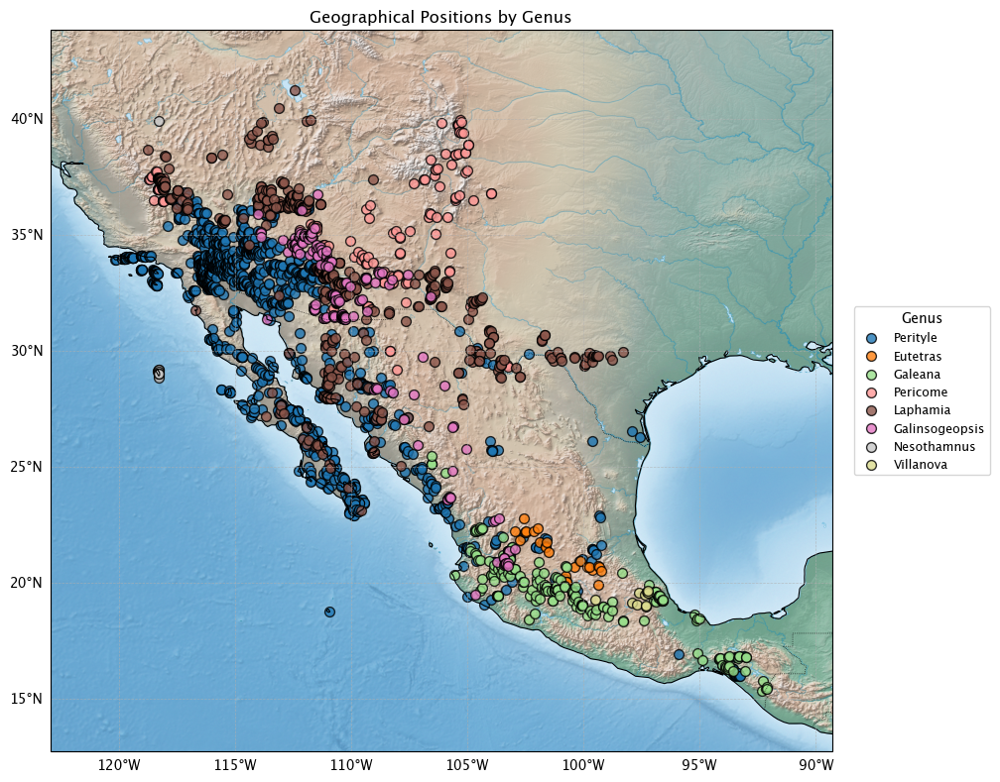

In [17]:
plot_geographical_positions(
    df_full,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedGenus', group_label='Genus'
)


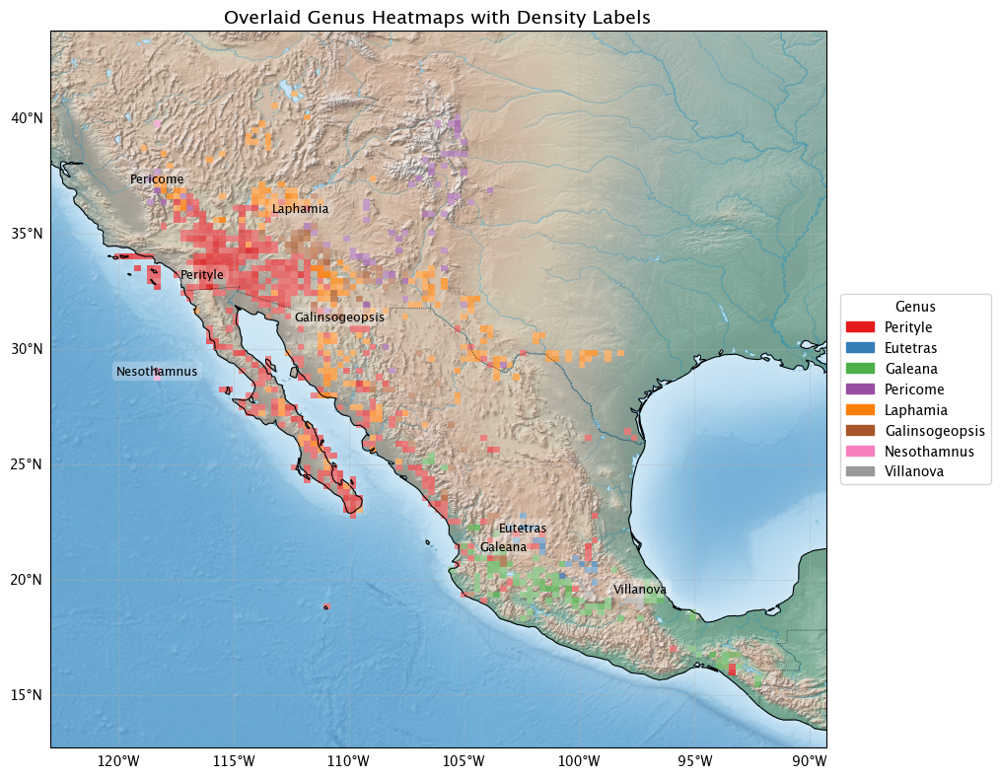

In [18]:
plot_geographical_heatmap_overlay(
    df_full,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedGenus', group_label='Genus'
)


## b. Perityle

In [19]:
perityle_df = df_full[df_full['acceptedGenus'] == 'Perityle']
print('Number of collected specimens:', len(perityle_df))
print('Species:', perityle_df['acceptedSpecies'].unique())


Number of collected specimens: 1486
Species: ['brandegeeana' 'rotundifolia' 'aurea' 'emoryi' 'crassifolia' 'cuneata'
 'rosei']


All of interest (from Nomenclator)
- Perityle aurea Rose
- Perityle brandegeeana Rose
- Perityle californica Benth.
- Perityle carterae (A.M. Powell) I.H. Lichter-Marck
- Perityle crassifolia Brandegee var. crassifolia
- Perityle crassifolia var. robusta (Rydb.) Everly
- Perityle cuneata Brandegee var. cuneata 
- Perityle cuneata var. marginata (Rydb.) I.M. Johnston 
- Perityle emoryi Torr.
- Perityle rosei Greenm.
- Perityle rotundifolia (Benth.) T.S. Brandegee
- Perityle socorrosensis Rose
- Perityle tenuifolius (Phil.) I.H. Lichter-Marck
- Perityle trichodonta S.F. Blake 

### i. All

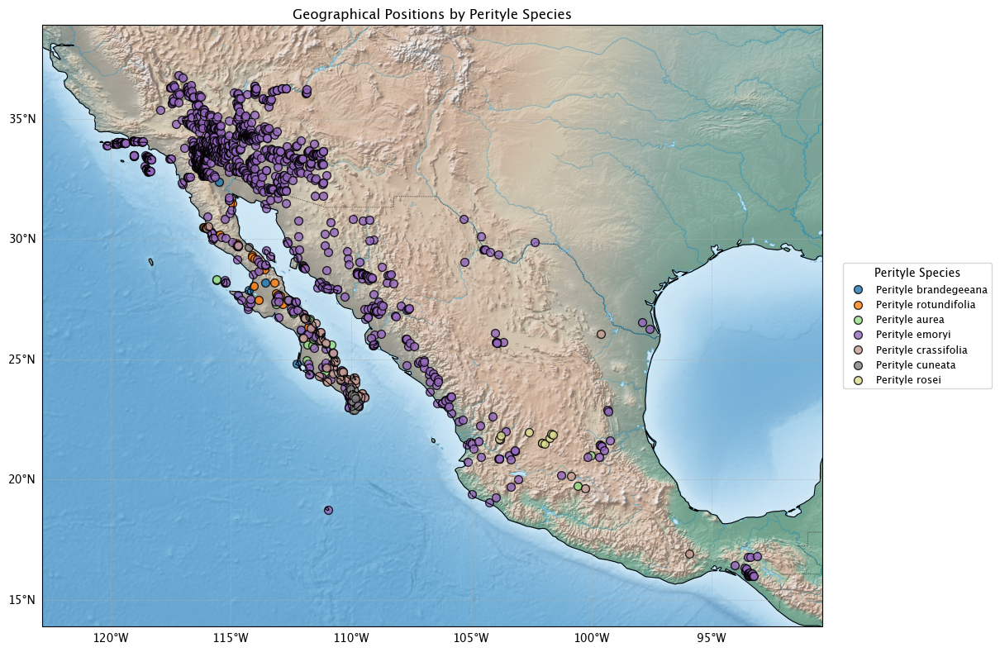

In [20]:
plot_geographical_positions(
    perityle_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species'
)


### ii. Baja, CA and SW U.S


In [21]:
perityle_subset_1 = ['aurea', 
'brandegeeana', 
'californica', 
'carterae', 
'crassifolia', 
'crassifolia', 
'cuneata', 
'cuneata', 
'emoryi',
'rotundifolia', 
'socorrosensis']

perityle_subset_1_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_1)]

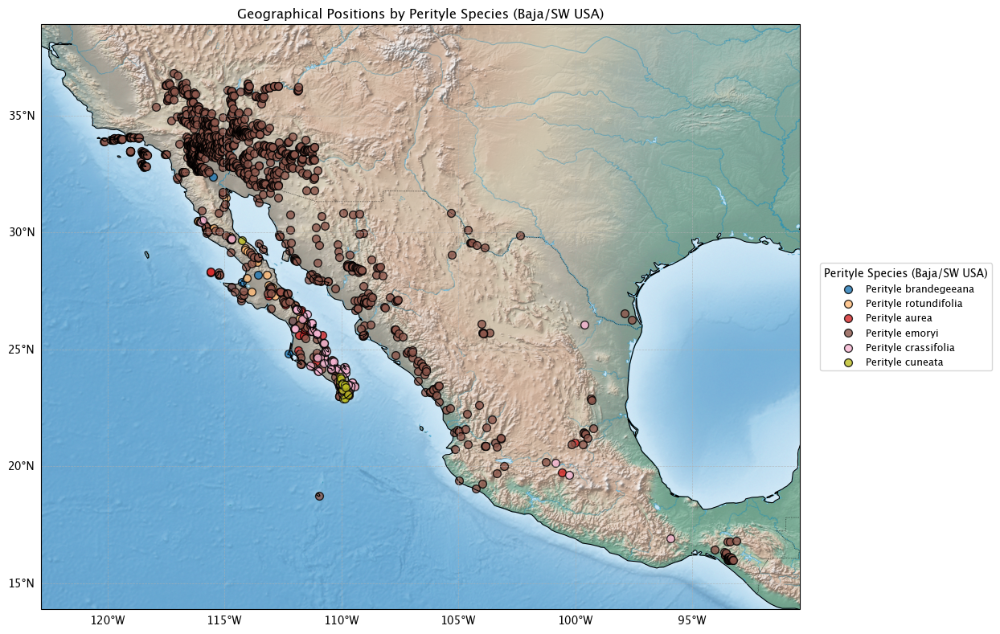

In [22]:
plot_geographical_positions(
    perityle_subset_1_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Baja/SW USA)'
)


### iii. Chile


In [23]:
perityle_subset_2 = ['tenuifolius', 'emoryi']

perityle_subset_2_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_2)]

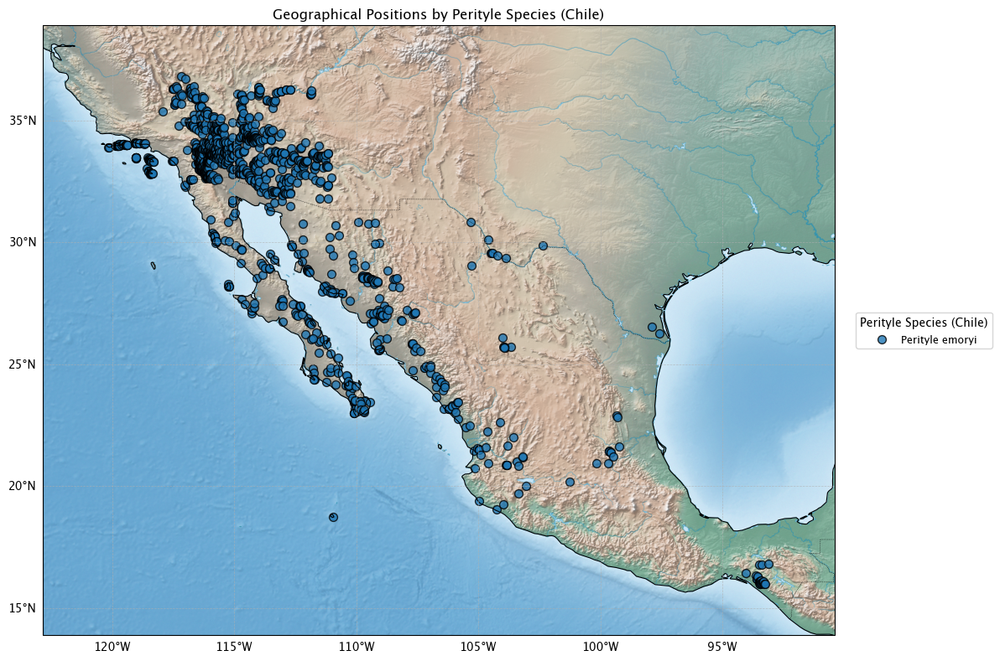

In [24]:
plot_geographical_positions(
    perityle_subset_2_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Chile)',
)


No data inside bounding box. Nothing to plot.


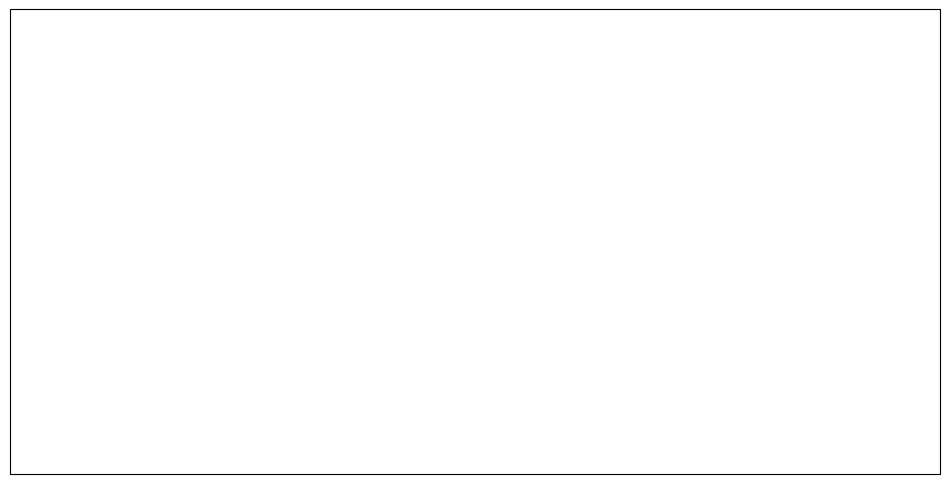

In [25]:
plot_geographical_positions(
    perityle_subset_2_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Chile)',
    bbox=[-75.0, -66.0, -56.0, -17.5]
)


### iv. Mainland Mexico


In [26]:
perityle_subset_3 = ['rosei', 'trichodonta']

perityle_subset_3_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_3)]

len(perityle_subset_3_df)

9

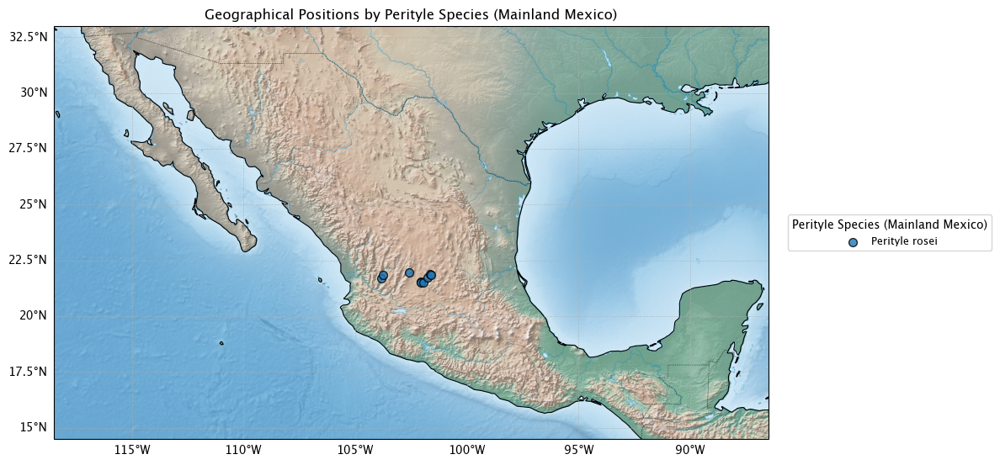

In [27]:
plot_geographical_positions(
    perityle_subset_3_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Mainland Mexico)',
    bbox = [-118.5, -86.5, 14.5, 33.0]
)


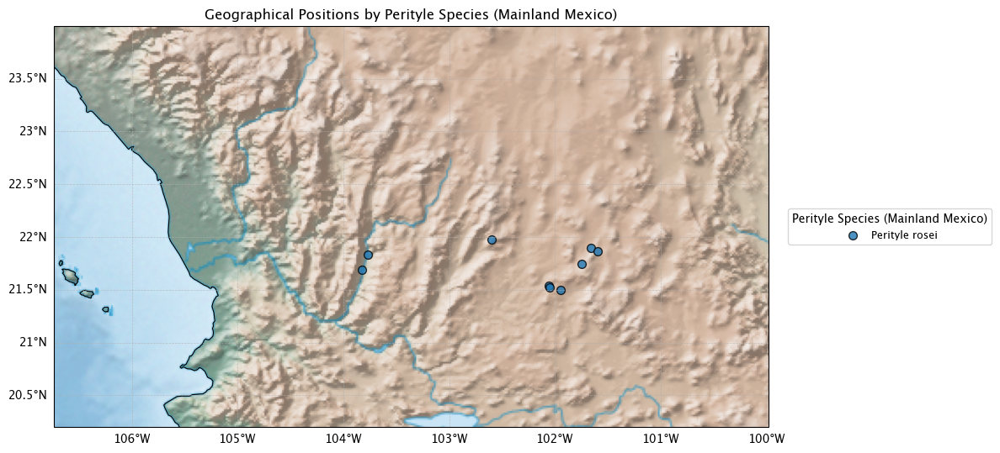

In [28]:
plot_geographical_positions(
    perityle_subset_3_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Mainland Mexico)',
    bbox = [-106.74,-99.98,20.2,24.0]
)


## c. Pericome

### i. All


In [29]:
pericome_df = df_full[df_full['acceptedGenus'] == 'Pericome']
print('Number of collected specimens:', len(pericome_df))
print('Species:', pericome_df['acceptedSpecies'].unique())


Number of collected specimens: 154
Species: ['caudata']


All of interest (from Nomenclator)
- Pericome caudata A. Gray
- Pericome macrocephala B.L. Rob.

In [30]:
pericome_subset_1 = ['caudata', 'macrocephala']

pericome_subset_1_df = pericome_df[pericome_df.acceptedSpecies.isin(pericome_subset_1)]

len(pericome_subset_1_df)

154

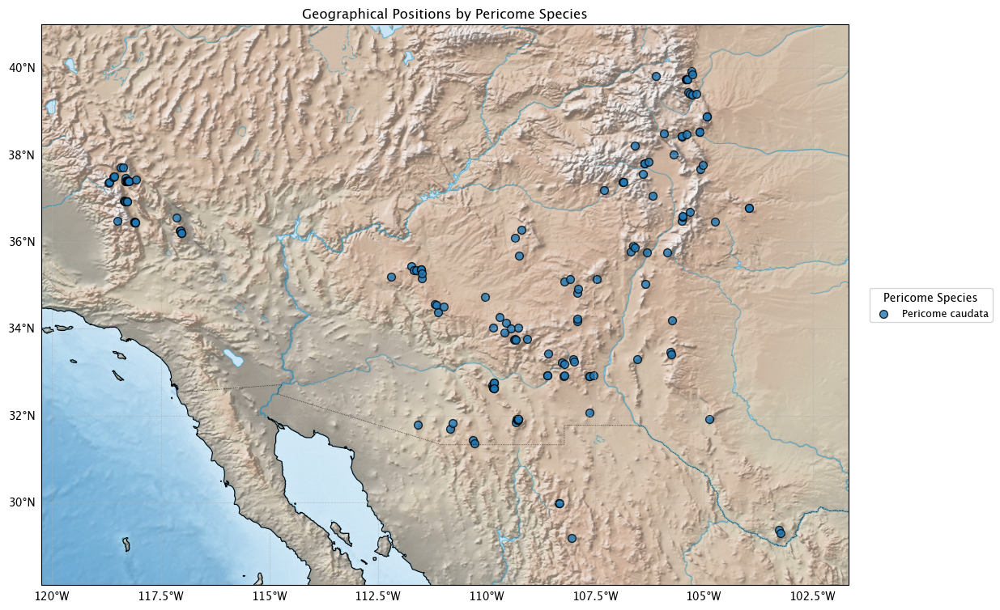

In [31]:
plot_geographical_positions(
    pericome_subset_1_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Pericome Species',
    # bbox = [-118.5, -86.5, 14.5, 33.0]
)


## d. Eutetras

### i. All


In [32]:
eutetras_df = df_full[df_full['acceptedGenus'] == 'Eutetras']
print('Number of collected specimens:', len(eutetras_df))
print('Species:', eutetras_df['acceptedSpecies'].unique())


Number of collected specimens: 25
Species: ['palmeri' 'pringlei']


All of interest (from Nomenclator)
- eutetras palmeri A. Gray
- eutetras pringlei Greenm.,

In [33]:
eutetras_subset_1 = ['palmeri', 'pringlei']

eutetras_subset_1_df = eutetras_df[eutetras_df.acceptedSpecies.isin(eutetras_subset_1)]

len(eutetras_subset_1_df)

25

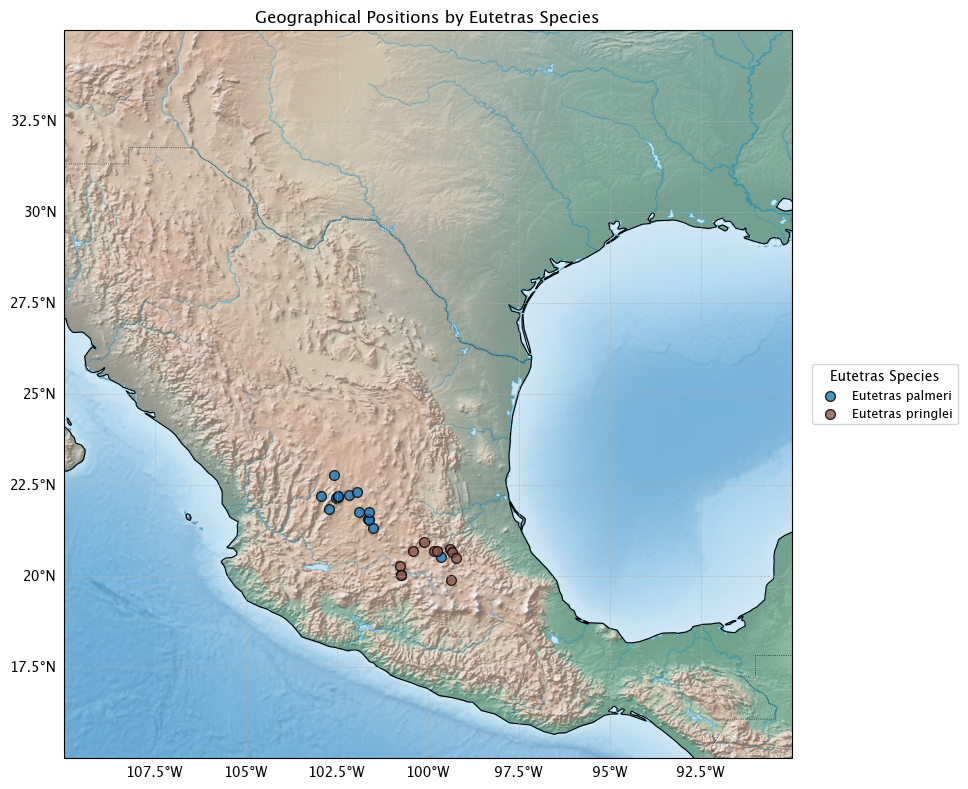

In [34]:
plot_geographical_positions(
    eutetras_subset_1_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Eutetras Species',
    bbox = [-110, -90, 15, 35]
)


## e. Nesothamnus

### i. All


In [35]:
nesothamnus_df = df_full[df_full['acceptedGenus'] == 'Nesothamnus']
print('Number of collected specimens:', len(nesothamnus_df))
print('Species:', nesothamnus_df['acceptedSpecies'].unique())


Number of collected specimens: 10
Species: ['incanus']


All of interest (from Nomenclator)
- Nesothamnus incanus (A. Gray) Rydb

In [36]:
nesothamnus_subset_1 = ['incanus']

nesothamnus_subset_1_df = nesothamnus_df[nesothamnus_df.acceptedSpecies.isin(nesothamnus_subset_1)]

len(nesothamnus_subset_1_df)

10

Guadalupe Island


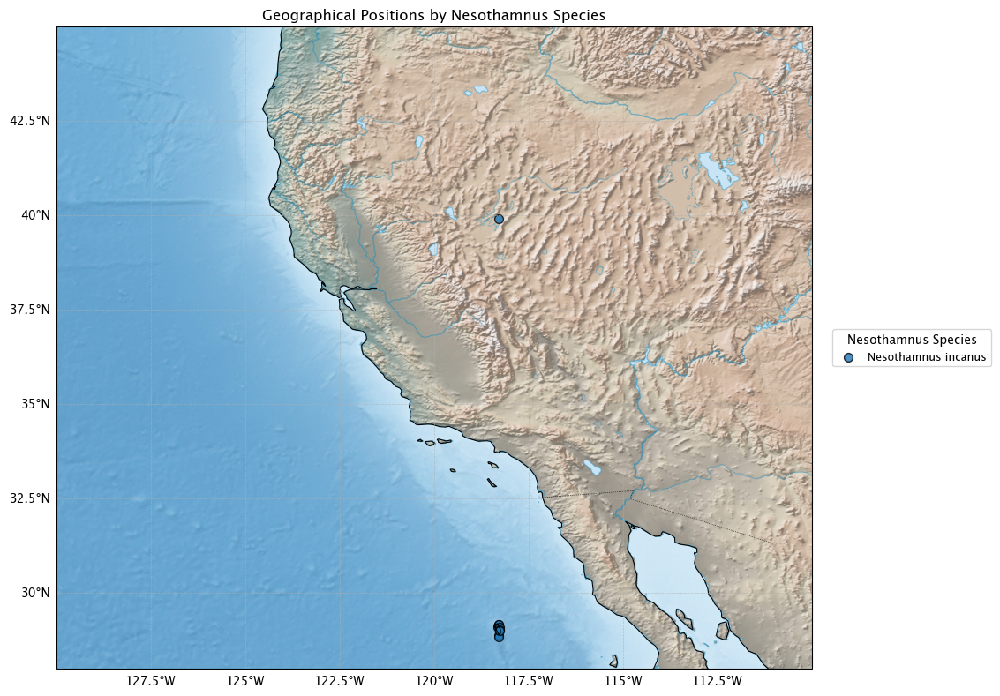

In [37]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-130, -110, 28, 45]
)


Looks like there's an errant latitude here!

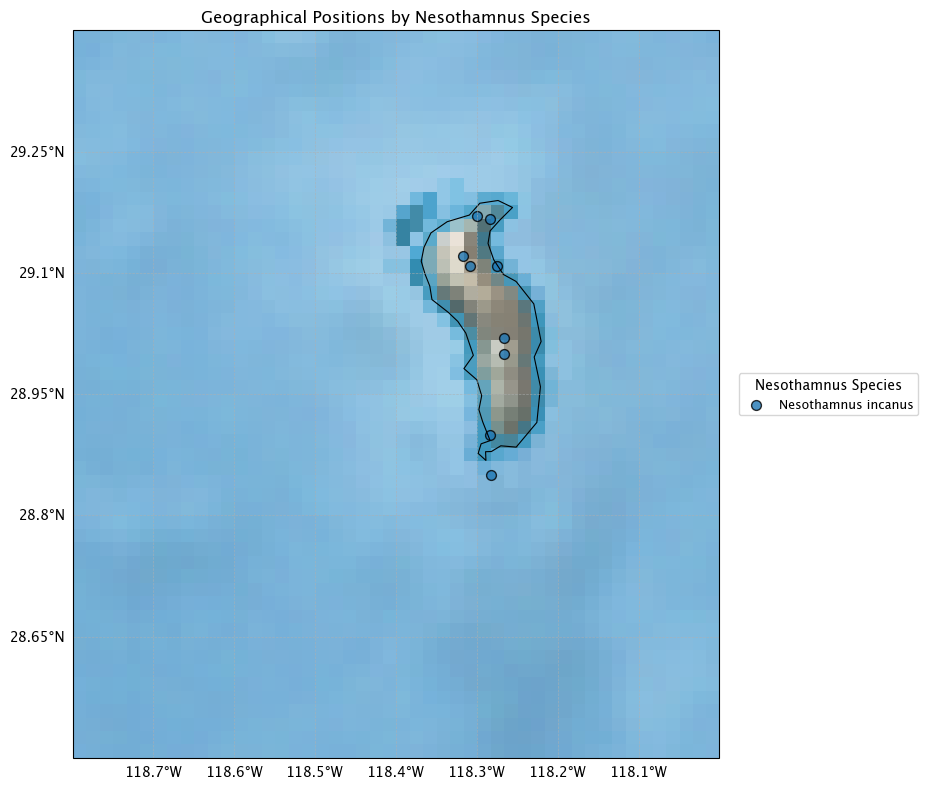

In [58]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-118.8, -118, 28.5, 29.4]
)


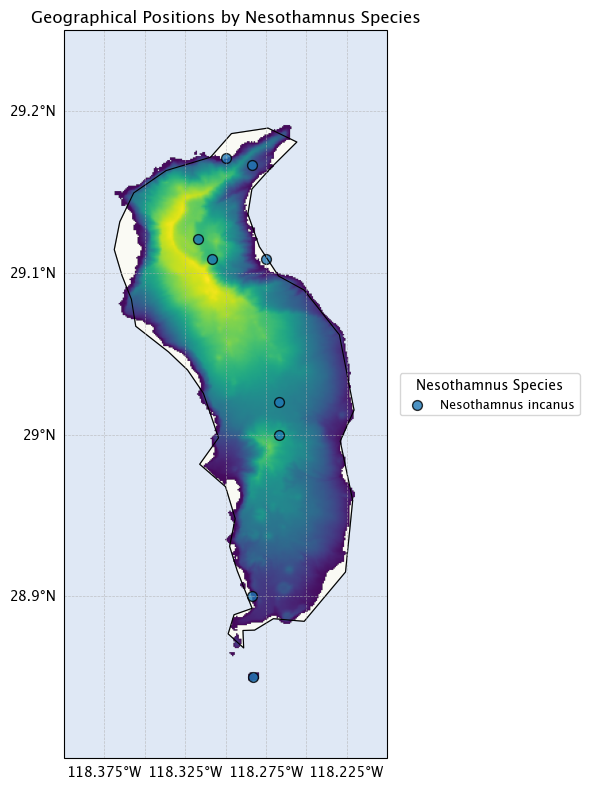

In [70]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    raster_path='../data/guadalupe/output_SRTMGL3.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-118.4, -118.2, 28.8, 29.25]
)


In [74]:
nesothamnus_subset_1_df

,X,OID,tribe,database,databaseid,countrycode,speciesCurated,CLYPPT_M_sl7_250m_ll,CRFVOL_M_sl1_250m_ll,CRFVOL_M_sl2_250m_ll,...,OPISRE3a,SLPSRT2a,TWISRE3a,decimallatitude_wgs,decimallongitude_wgs,Albers_lat,Albers_lon,acceptedName,acceptedGenus,acceptedSpecies
475128,475128,476562,Perityleae,GBIF,371053819,MX,Perityle incana,29.0,26.0,24.0,...,1581.0,32,62.0,29.12100,-118.317000,-2073525.453,-1.024789e+06,Nesothamnus incanus,Nesothamnus,incanus
475129,475129,476563,Perityleae,GBIF,1019001707,MX,Perityle incana,30.0,25.0,23.0,...,1491.0,32,61.0,29.10833,-118.308330,-2073074.641,-1.026396e+06,Nesothamnus incanus,Nesothamnus,incanus
475130,475130,476564,Perityleae,GBIF,1019002318,MX,Perityle incana,21.0,39.0,37.0,...,1562.0,43,58.0,29.17083,-118.300000,-2070639.099,-1.019586e+06,Nesothamnus incanus,Nesothamnus,incanus
475131,475131,476565,Perityleae,GBIF,1019001884,MX,Perityle incana,31.0,13.0,12.0,...,1537.0,0,139.0,39.90833,-118.291670,-1777844.250,1.991832e+05,Nesothamnus incanus,Nesothamnus,incanus
475132,475132,476566,Perityleae,GBIF,1259881876,MX,Perityle incana,29.0,37.0,35.0,...,1570.0,13,70.0,28.90000,-118.283330,-2076373.572,-1.050239e+06,Nesothamnus incanus,Nesothamnus,incanus
475133,475133,476567,Perityleae,GBIF,1019002370,MX,Perityle incana,32.0,36.0,35.0,...,1617.0,43,59.0,29.16667,-118.283330,-2069231.321,-1.020415e+06,Nesothamnus incanus,Nesothamnus,incanus
475134,475134,476568,Perityleae,GBIF,371053767,MX,Perityle incana,31.0,42.0,40.0,...,NaN,37,NaN,28.85000,-118.283000,-2077681.797,-1.055834e+06,Nesothamnus incanus,Nesothamnus,incanus
475135,475135,476569,Perityleae,GBIF,1019001841,MX,Perityle incana,NaN,NaN,NaN,...,1419.0,95,66.0,29.10833,-118.275000,-2070034.599,-1.027124e+06,Nesothamnus incanus,Nesothamnus,incanus
475136,475136,476570,Perityleae,GBIF,1098417982,MX,Perityle incana,40.0,20.0,18.0,...,1553.0,13,75.0,29.02000,-118.266670,-2071639.043,-1.037186e+06,Nesothamnus incanus,Nesothamnus,incanus
475137,475137,476571,Perityleae,IDIG,7c0ff019-b6ba-4f25-a61c-0f97d9fe77a4,MX,Perityle incana,35.0,33.0,31.0,...,1618.0,5,63.0,29.00000,-118.266667,-2072173.995,-1.039423e+06,Nesothamnus incanus,Nesothamnus,incanus


In [73]:
plot_3d_relief_with_species(
    tif_path='../data/guadalupe/output_SRTMGL3.tif',
    group_col='acceptedName',
    group_label='Nesothamnus Species',
    bbox = [-118.4, -118.2, 28.8, 29.25], #    bbox=[-119, -111, 35, 42],
    df=nesothamnus_subset_1_df,
    elev_exaggeration=0.00005,
    point_size=25.0,
    lift_above_surface=0.01,
    surface_patch_scale=15.0,
    colormap='gist_earth'
    
)


Widget(value='<iframe src="http://localhost:55293/index.html?ui=P_0x3314b4050_14&reconnect=auto" class="pyvist…

## f. Galinsogeopsis

### i. All

Number of collected specimens: 182
Species: ['ciliata' 'coronopifolia' 'feddemae' 'jaliscana' 'microcephala' 'turneri']


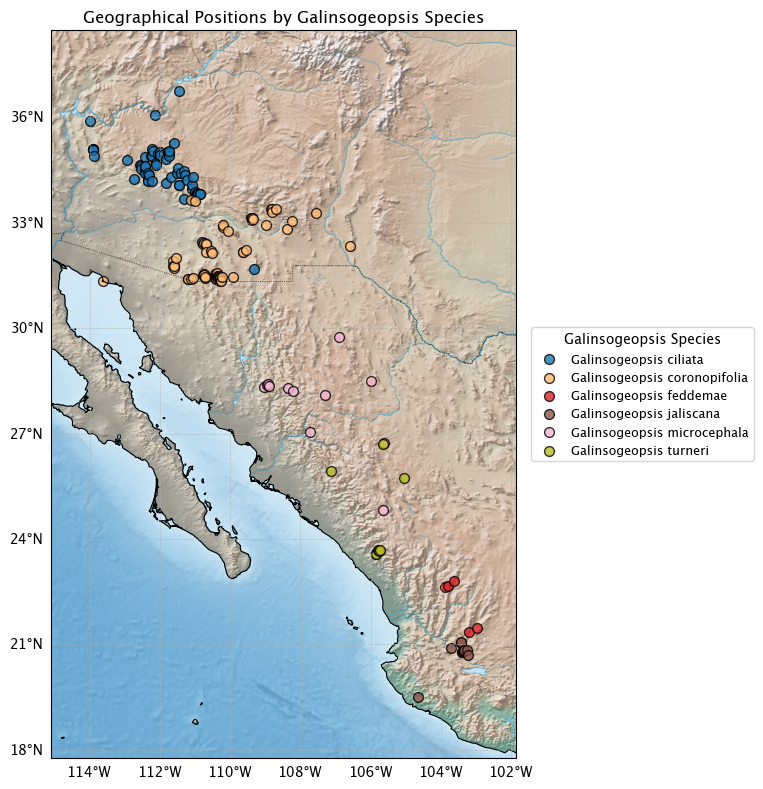

In [39]:
galinsogeopsis_df = df_full[df_full['acceptedGenus'] == 'Galinsogeopsis']
print('Number of collected specimens:', len(galinsogeopsis_df))
print('Species:', galinsogeopsis_df['acceptedSpecies'].unique())

plot_geographical_positions(
    galinsogeopsis_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species'
)


### ii. Widespread

No data inside bounding box. Nothing to plot.


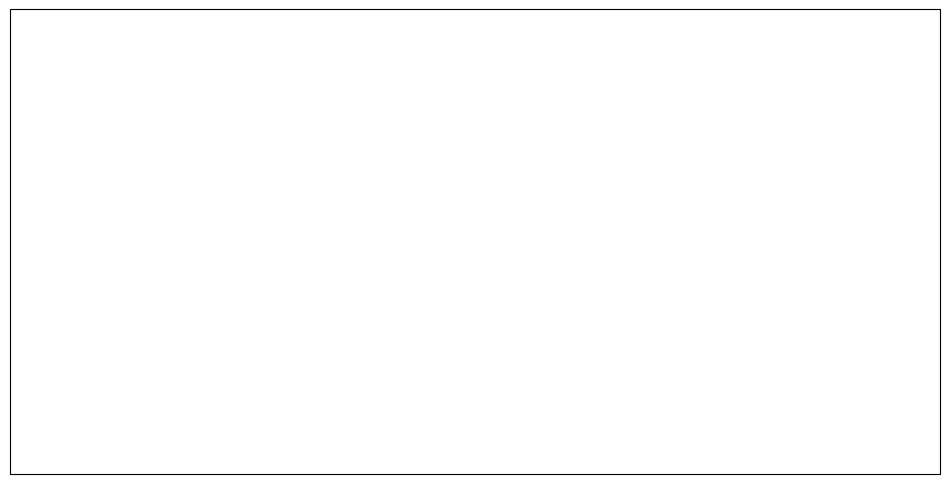

In [40]:
gali_subset_1 = ['microglossa', 'microglossa']  # covers both varieties
gali_subset_1_df = galinsogeopsis_df[galinsogeopsis_df['acceptedSpecies'].isin(gali_subset_1)]

plot_geographical_positions(
    gali_subset_1_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species (Widespread)'
)


### iii. Isolated

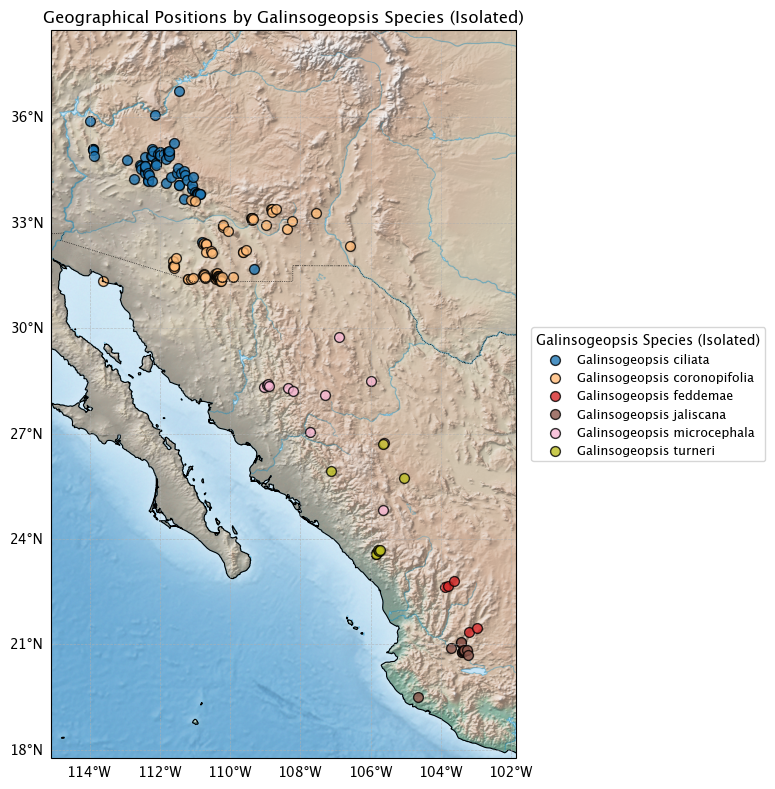

In [41]:
gali_subset_2 = [
    'canescens', 'ciliata', 'coronopifolia', 'feddemae', 'glaucescens', 'harkerae', 'hofmeisteria',
    'jaliscana', 'lineariloba', 'microcephala', 'montana', 'pseudociliata', 'scopulorum',
    'turneri', 'vigilans'
]
gali_subset_2_df = galinsogeopsis_df[galinsogeopsis_df['acceptedSpecies'].isin(gali_subset_2)]

plot_geographical_positions(
    gali_subset_2_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species (Isolated)'
)


## g. Laphamia

### i. All

Number of collected specimens: 499
Species: ['aglossa' 'angustifolia' 'cernua' 'toumeyi' 'cordifolia' 'dissecta'
 'gentryi' 'gilensis' 'huecoensis' 'intricata' 'inyoensis' 'lemmonii'
 'leptoglossa' 'lindheimeri' 'lobata' 'megalocephala' 'sanchezii'
 'quinqueflora' 'rupestris' 'stansburyi' 'staurophylla' 'palmeri' 'vaseyi'
 'villosa']


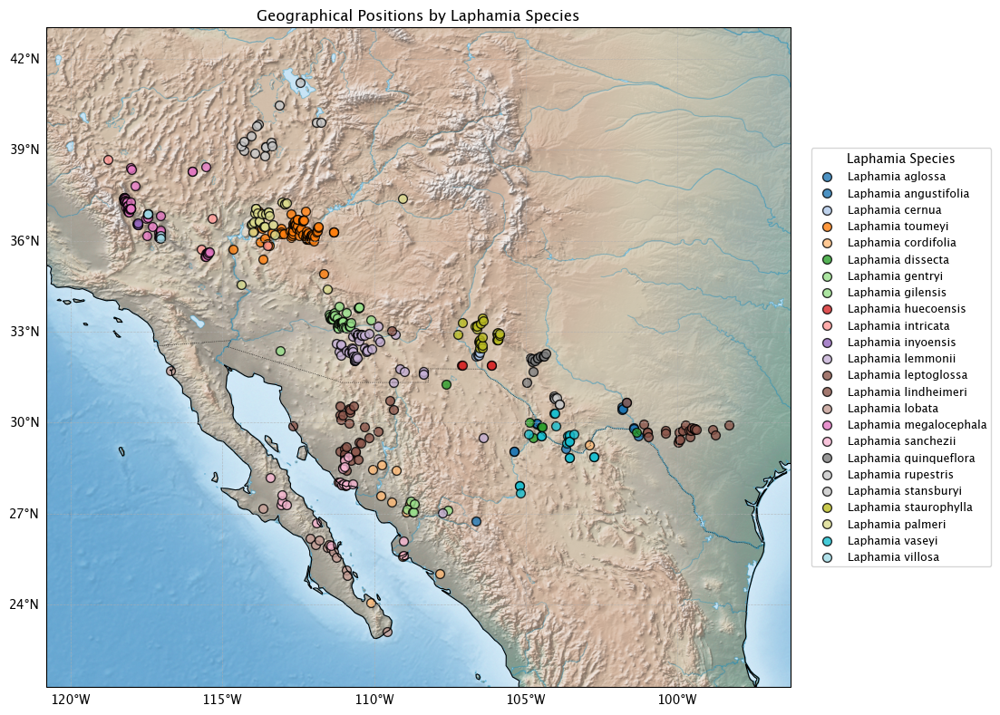

In [42]:
laphamia_df = df_full[df_full['acceptedGenus'] == 'Laphamia']
print('Number of collected specimens:', len(laphamia_df))
print('Species:', laphamia_df['acceptedSpecies'].unique())

plot_geographical_positions(
    laphamia_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia Species'
)


### ii. Sonora/Sinaloa + Baja California

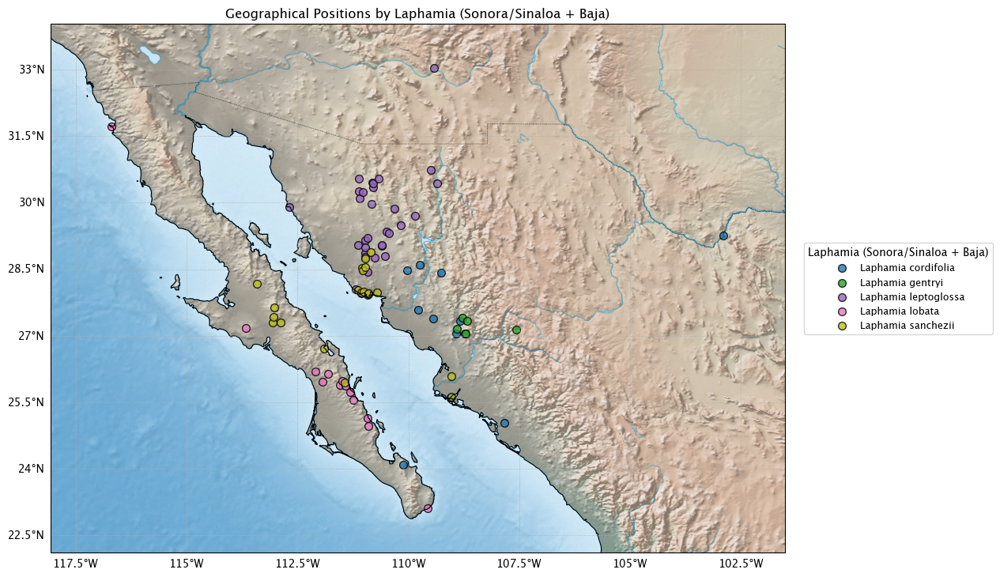

In [43]:
laphamia_subset_1 = ['reinana', 'leptoglossa', 'cordifolia', 'sanchezii', 'lobata', 'gentryi', 'batopilensis', 'lloydii']
laphamia_subset_1_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_1)]

plot_geographical_positions(
    laphamia_subset_1_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Sonora/Sinaloa + Baja)'
)


### iii. Big Bend Region

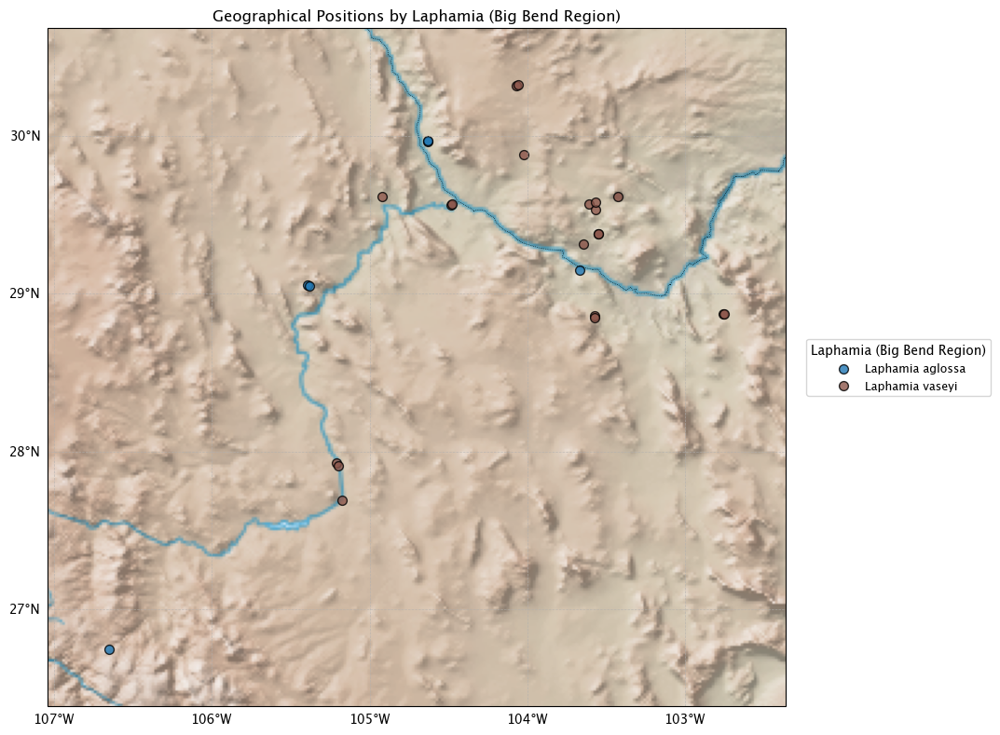

In [44]:
laphamia_subset_2 = ['parryi', 'vaseyi', 'aglossa']
laphamia_subset_2_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_2)]

plot_geographical_positions(
    laphamia_subset_2_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Big Bend Region)'
)


### iv. Western Texas Sky Islands

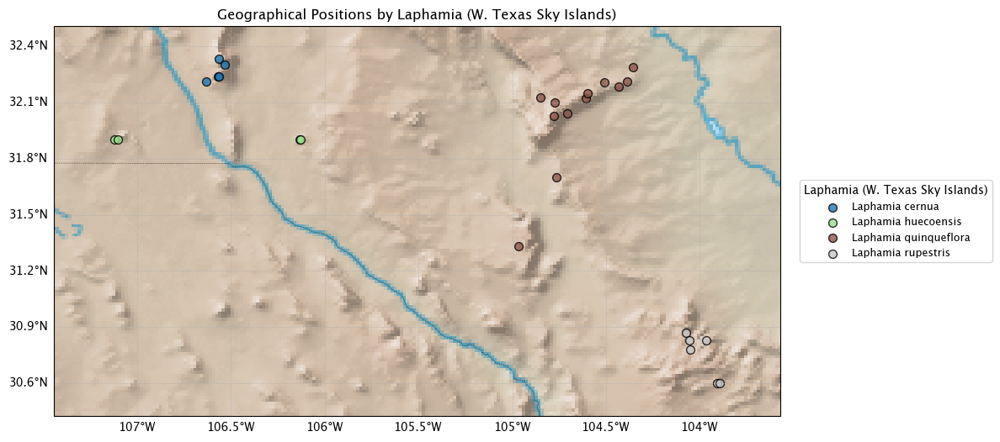

In [45]:
laphamia_subset_3 = ['rupestris', 'cinerea', 'fosteri', 'quinqueflora', 'castillonii',
                     'bisetosa', 'cernua', 'huecoensis', 'warnockii']
laphamia_subset_3_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_3)]

plot_geographical_positions(
    laphamia_subset_3_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (W. Texas Sky Islands)'
)


### v. AZ/New Mexico Sky Islands

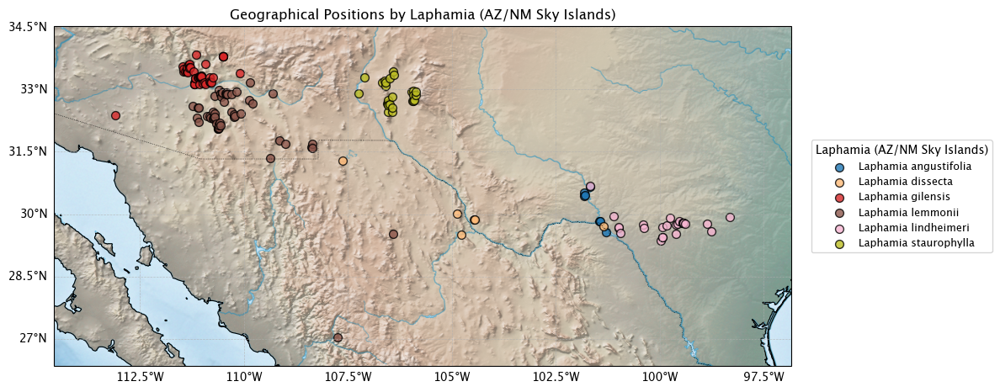

In [46]:
laphamia_subset_4 = [
    'dissecta', 'cochisensis', 'angustifolia', 'lindheimeri', 'staurophylla', 'vandevenderi',
    'lemmonii', 'ambrosiifolia', 'gilensis', 'coahuilensis', 'saxicola'
]
laphamia_subset_4_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_4)]

plot_geographical_positions(
    laphamia_subset_4_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (AZ/NM Sky Islands)'
)


### vi. Great Basin Clade

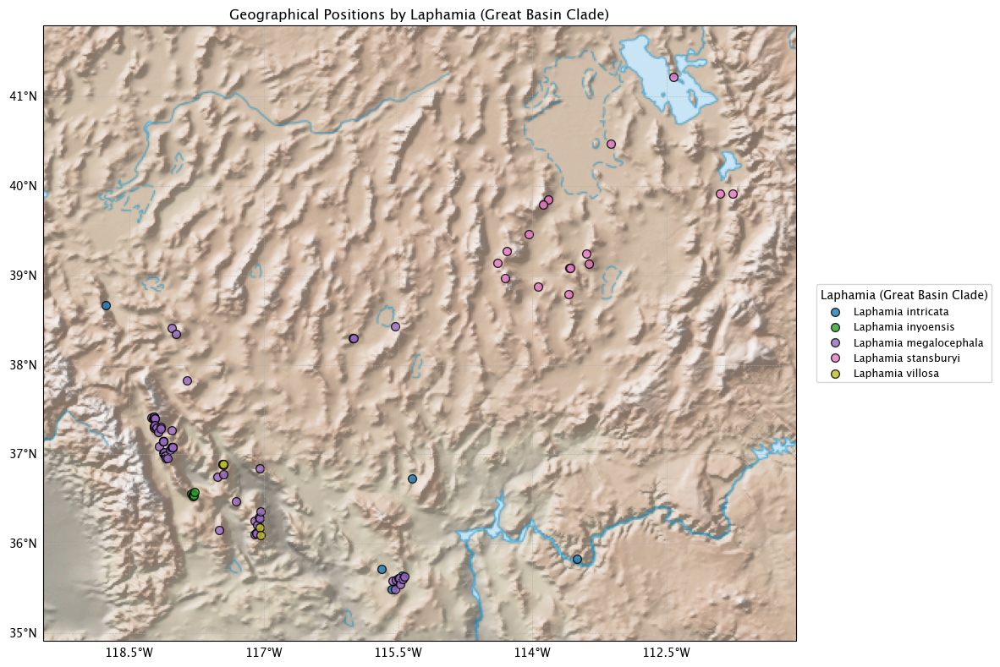

In [47]:
laphamia_subset_5 = [
    'congesta', 'stansburyi', 'tenella', 'specuicola', 'gracilis', 'intricata',
    'megalocephala', 'villosa', 'inyoensis'
]
laphamia_subset_5_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_5)]

plot_geographical_positions(
    laphamia_subset_5_df,
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)


In [48]:
import pyvista as pv
import ipywidgets
import trame
pv.set_jupyter_backend('trame')  # <-- Important line

In [53]:
plot_3d_relief_with_species(
    tif_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    bbox=[-119, -111, 35, 42],
    df=laphamia_subset_5_df,
    elev_exaggeration=0.0008,
    point_size=15.0,
    lift_above_surface=0.05,
    surface_patch_scale=5.0,
    colormap='gist_earth'
    
)


Widget(value='<iframe src="http://localhost:55293/index.html?ui=P_0x17e433750_4&reconnect=auto" class="pyvista…